Experimental Dataset - 2D class - class 39- 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_30_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_30_epoch_255_checkpoint.pth'
EPOCH_NUMBER = 255

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_30_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (4917, 1, 128, 128) metadata.shape (4917, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(4917, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_30_128x128/train_vae/epoch_255_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

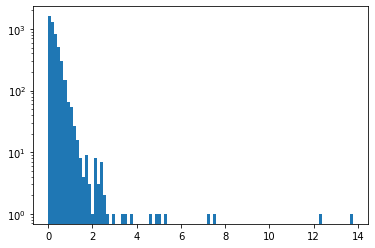

0.3076966410550946 0.4419991678740162


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

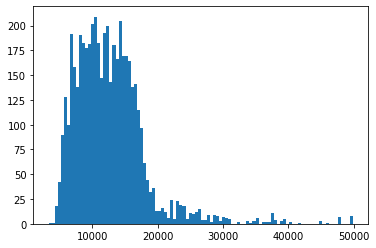

3333.739502 12692.950592391499 5603.567648669399


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

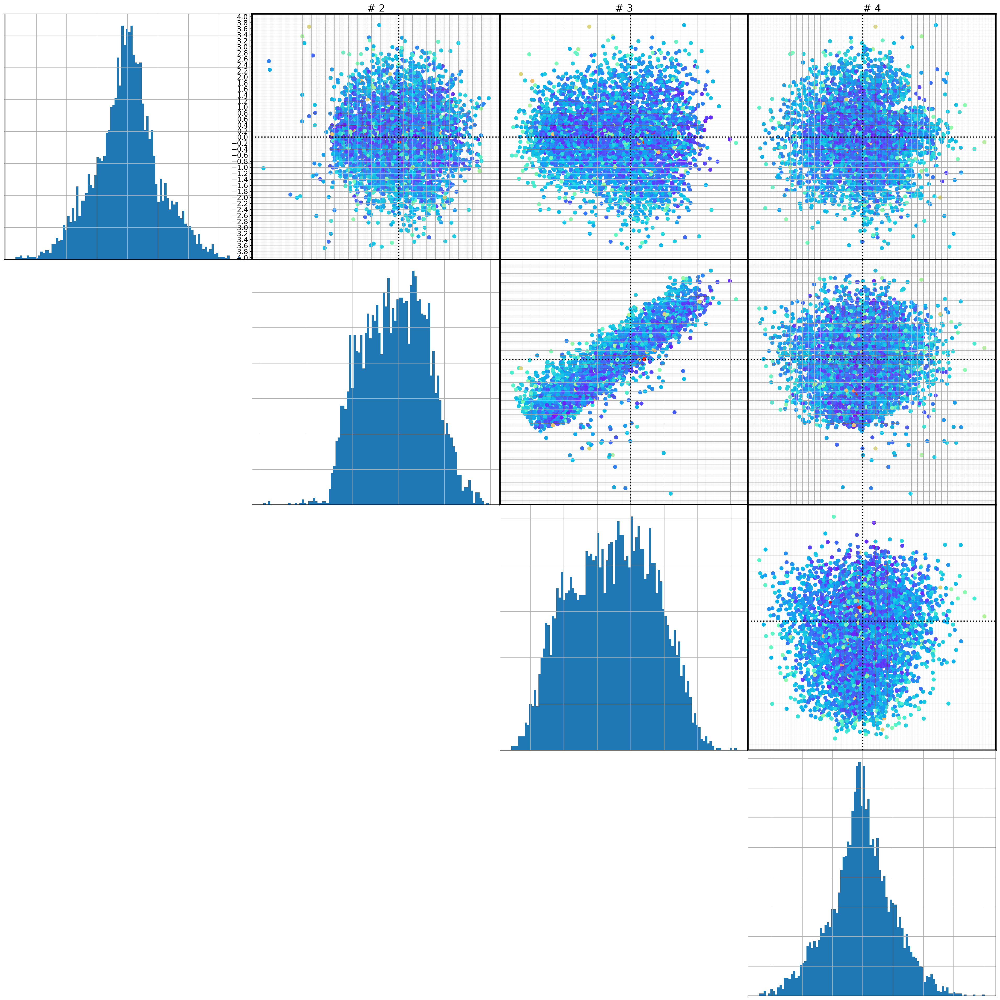

In [11]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [12]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

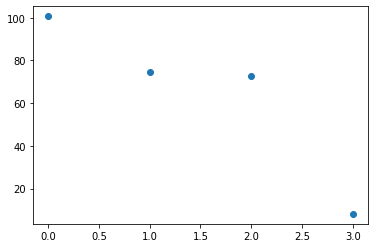

In [13]:
plt.plot(L, 'o')

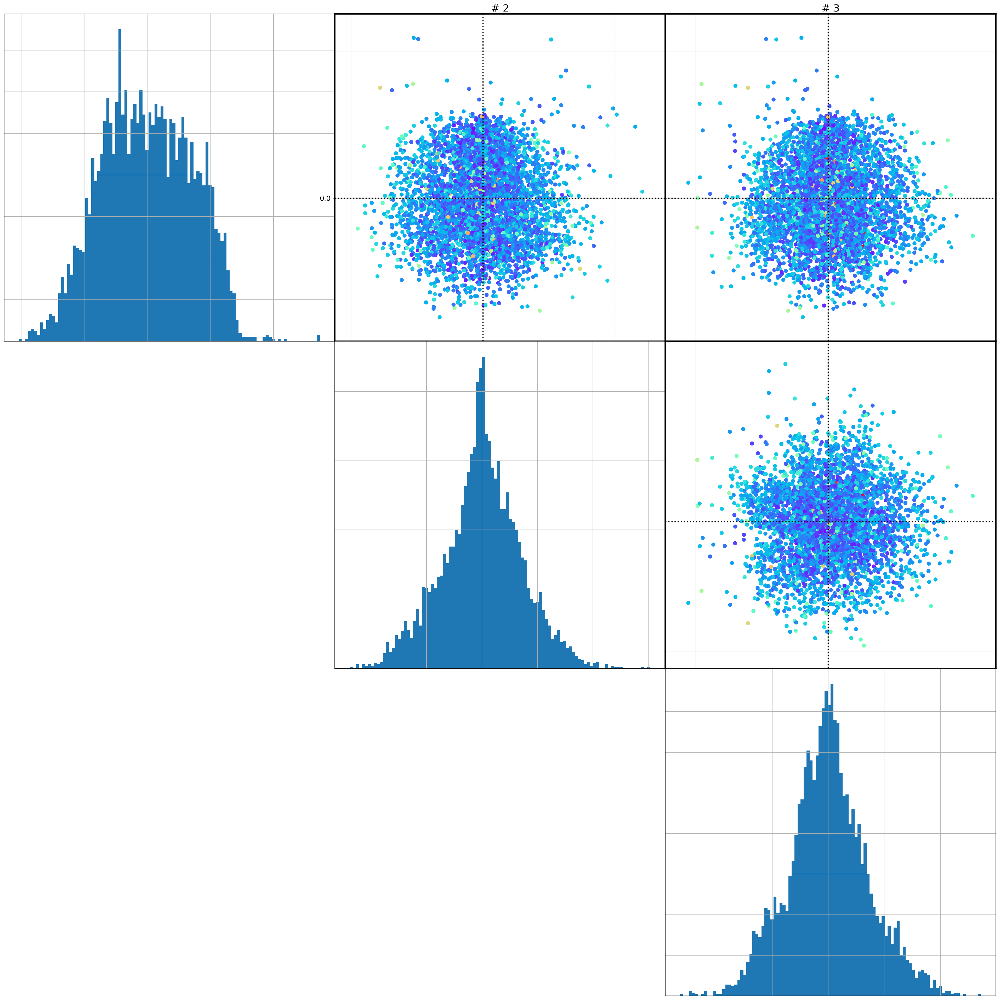

In [14]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

# Data curation

## Outlier prediction

In [15]:
Zscore_set=2

In [16]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(4883,) (34,)


AUC(robust_covar) = 0.8335521798315886
AUC(isolation_forest) = 0.8379250942646154
AUC(local_outlier_detection) = 0.8733782269819662


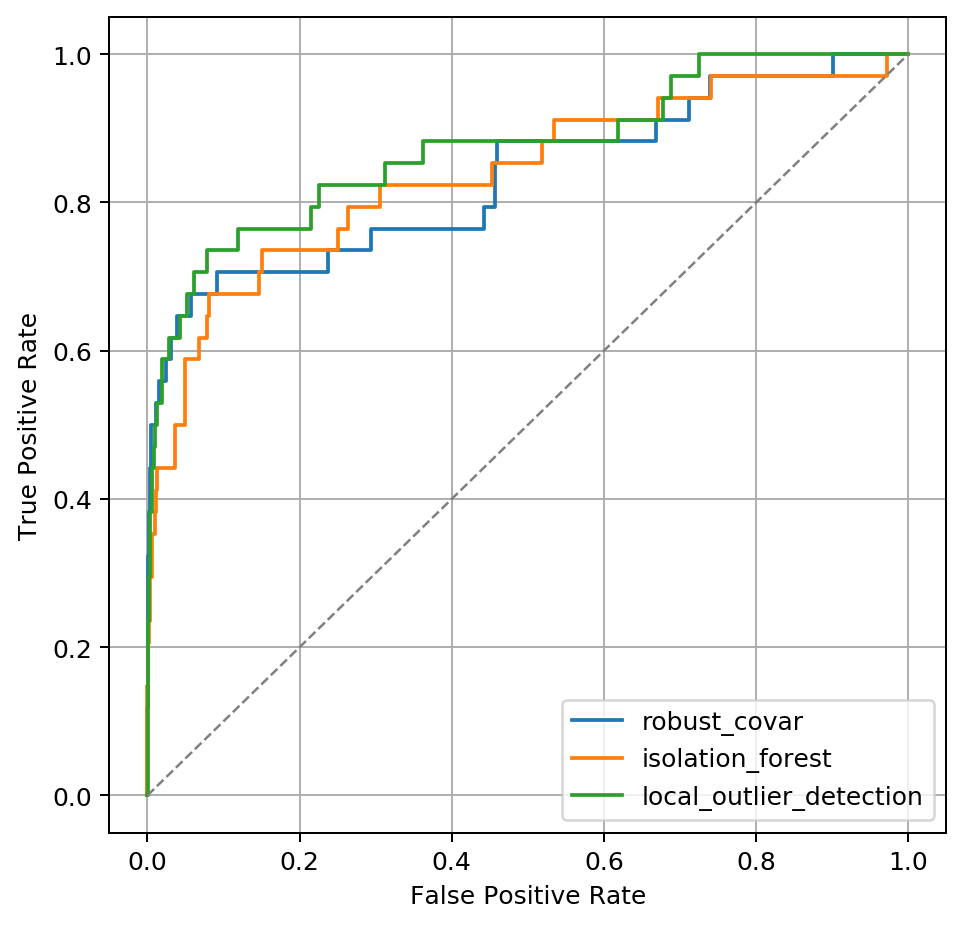

In [17]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#

In [18]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

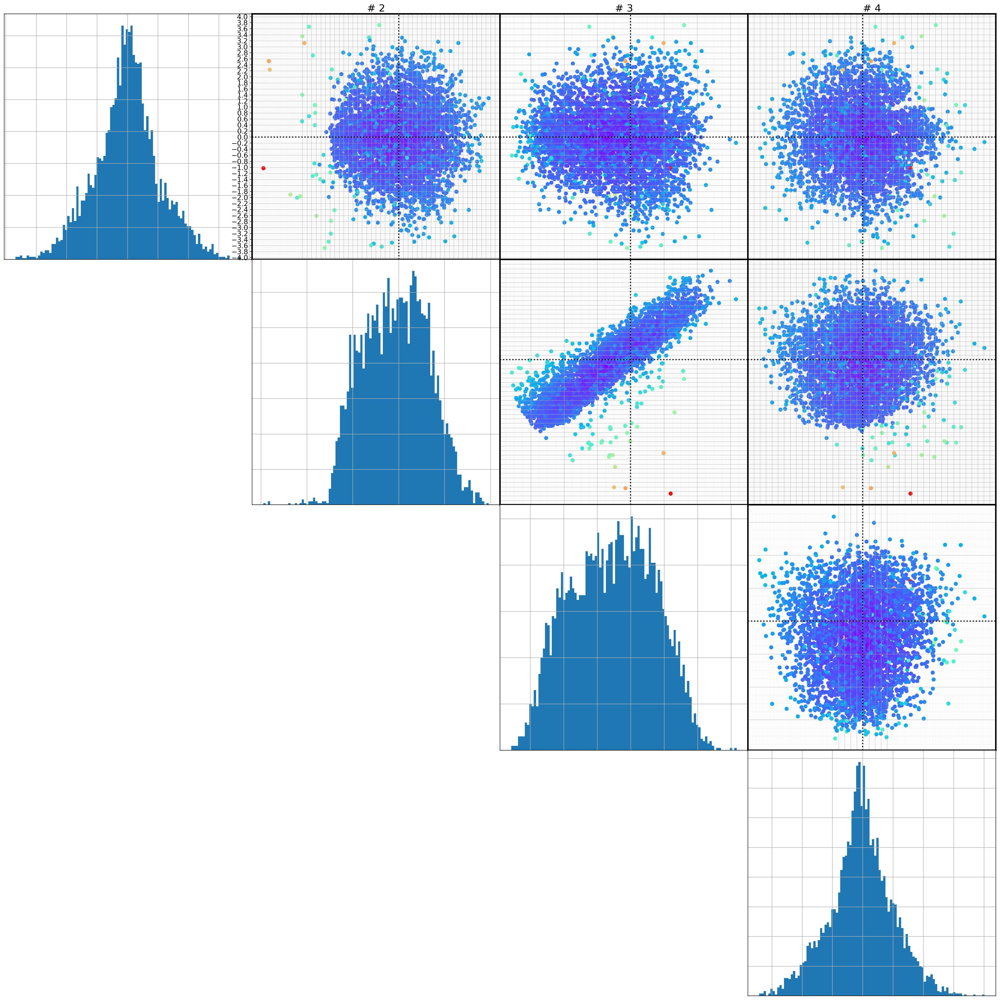

In [19]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [20]:
measure_threshold=3

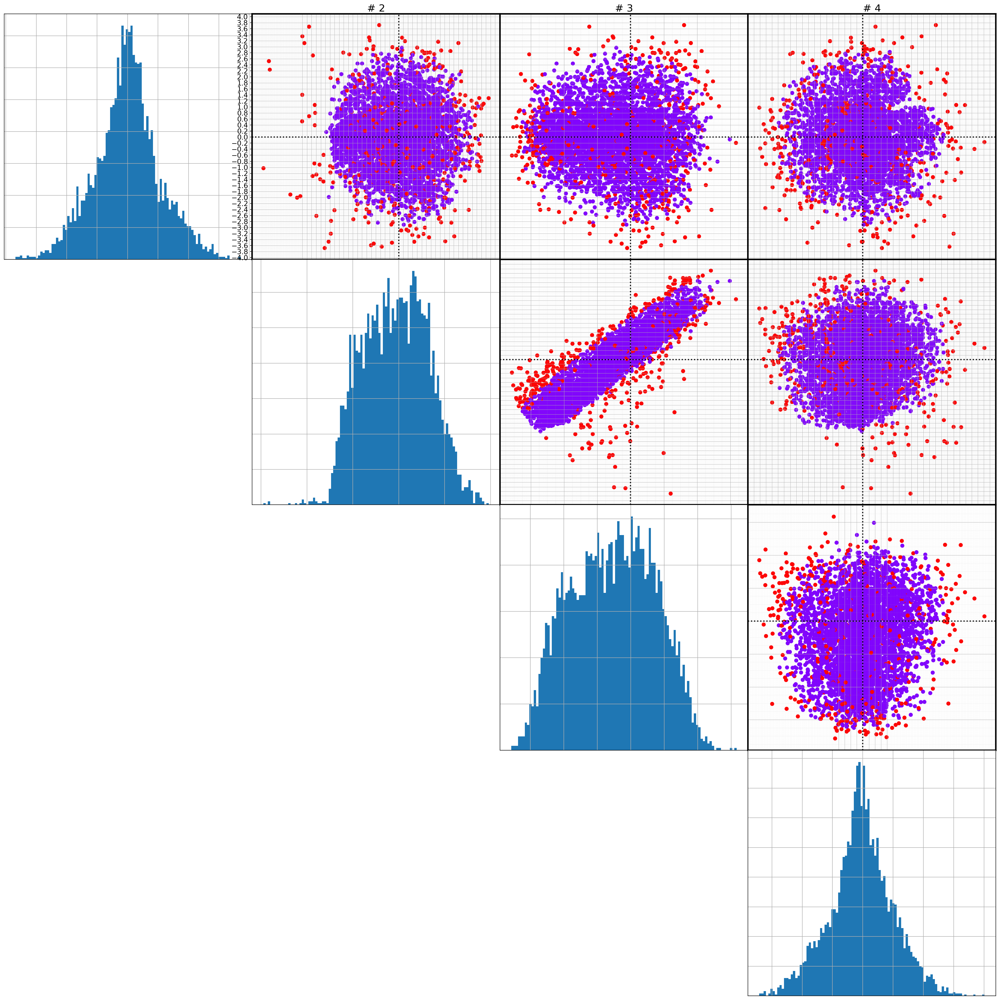

In [21]:
viz.biplots(mus, n=4, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), 
            figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [22]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4416, 4)
(4416,)
(4416,)
(4416,)


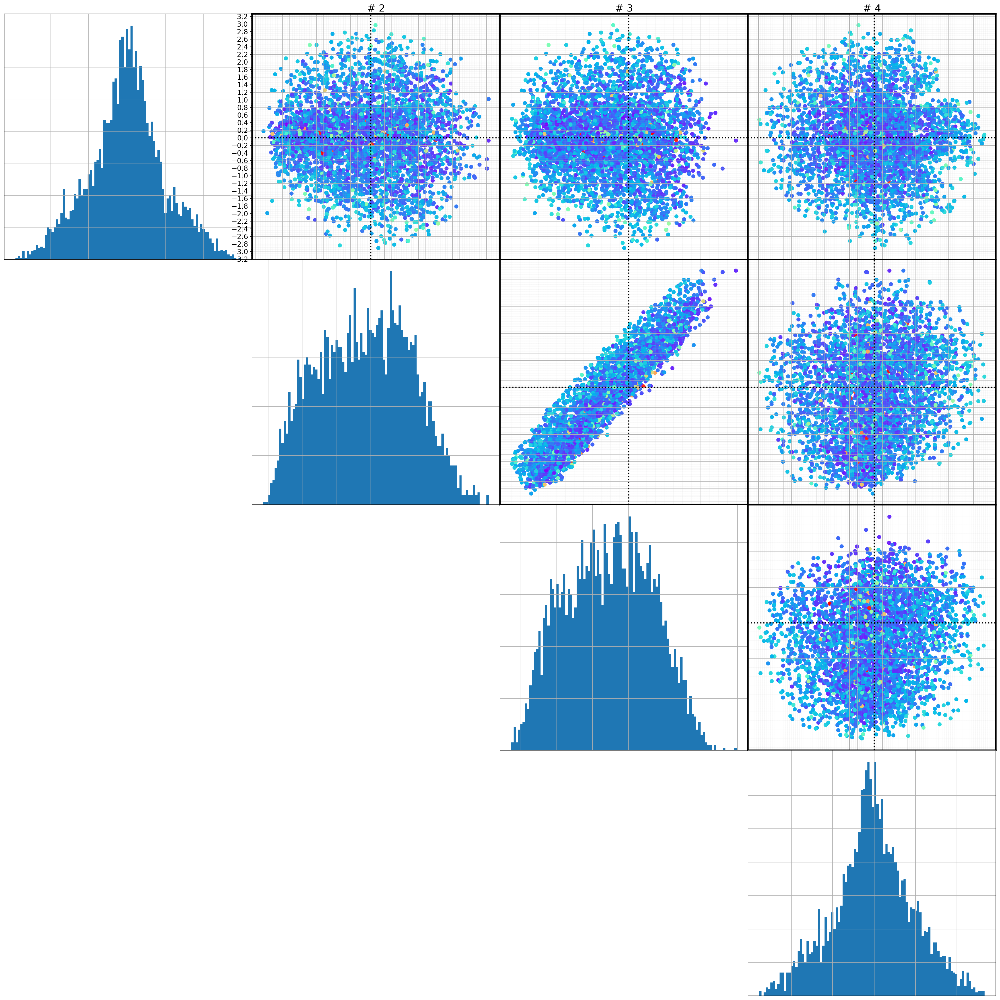

In [23]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=defocus_kept)

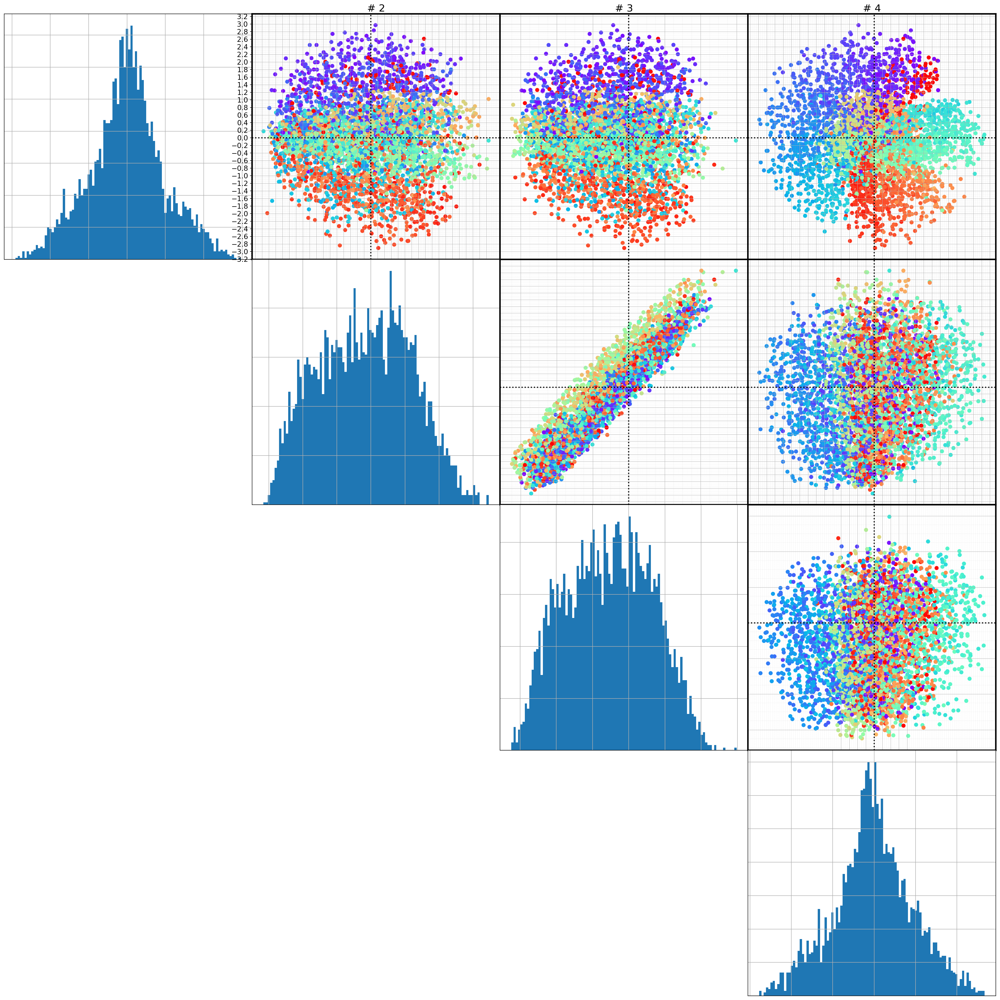

In [24]:
viz.biplots(mus_kept, n=4, show_histo=True, nbins=100, c=angle_kept)

## Remove user-defined outliers

In our case, knowledge of metadata helps getting rid of "bad" data (i.e. defocus values out of reasonable range)

In [25]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]
mus_curated     = mus_kept[index,:]
angle_curated   = angle_kept[index]
defocus_curated = defocus_kept[index]
Zscore_curated  = Zscore_kept[index]

# Project in PCA space

In [26]:
center_curated = np.mean(mus_curated,axis=0) #np.zeros(mus.shape) #
U_curated, L_curated, Vt_curated = np.linalg.svd(mus_curated - center_curated, full_matrices=False)

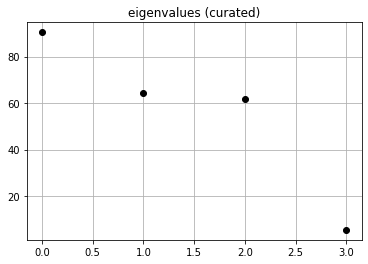

In [27]:
plt.plot(L_curated, 'ko')
plt.title('eigenvalues (curated)')
plt.grid()
plt.show()

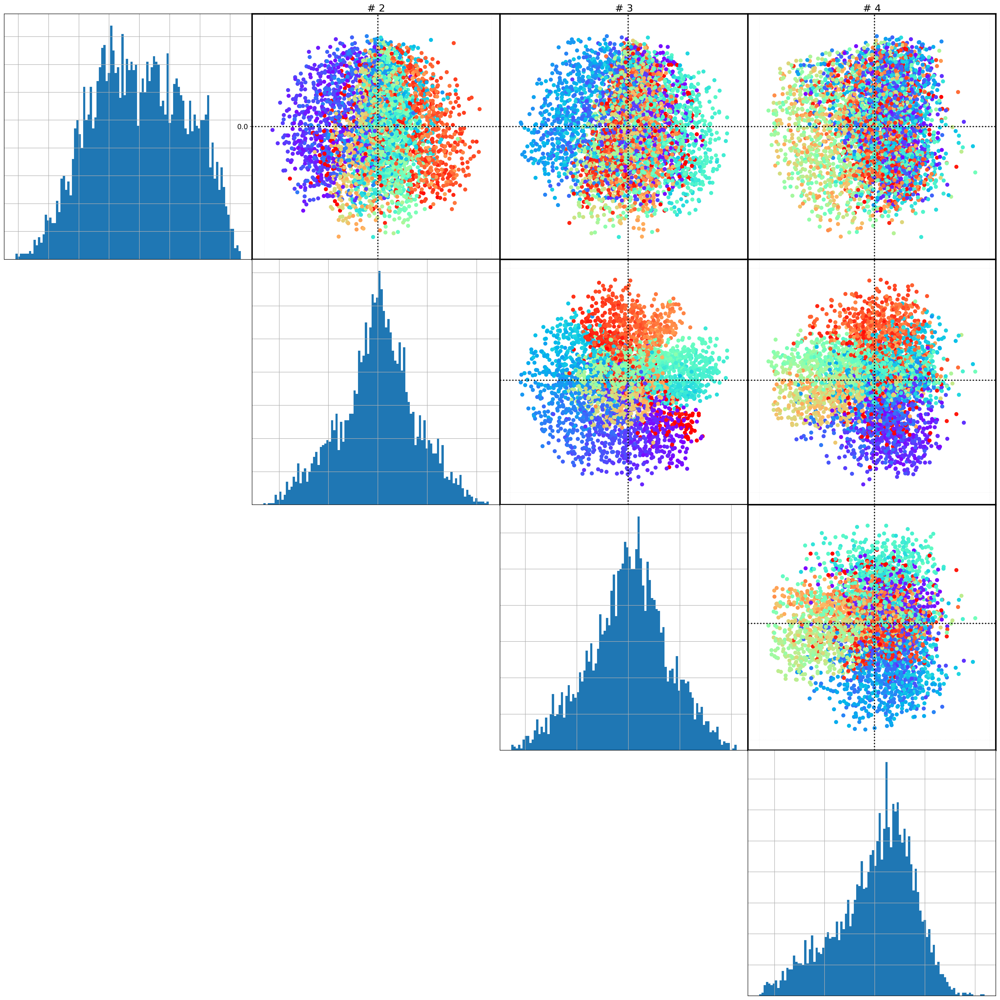

In [28]:
viz.biplots(U_curated, n=4, show_histo=True, nbins=100, c=angle_curated)

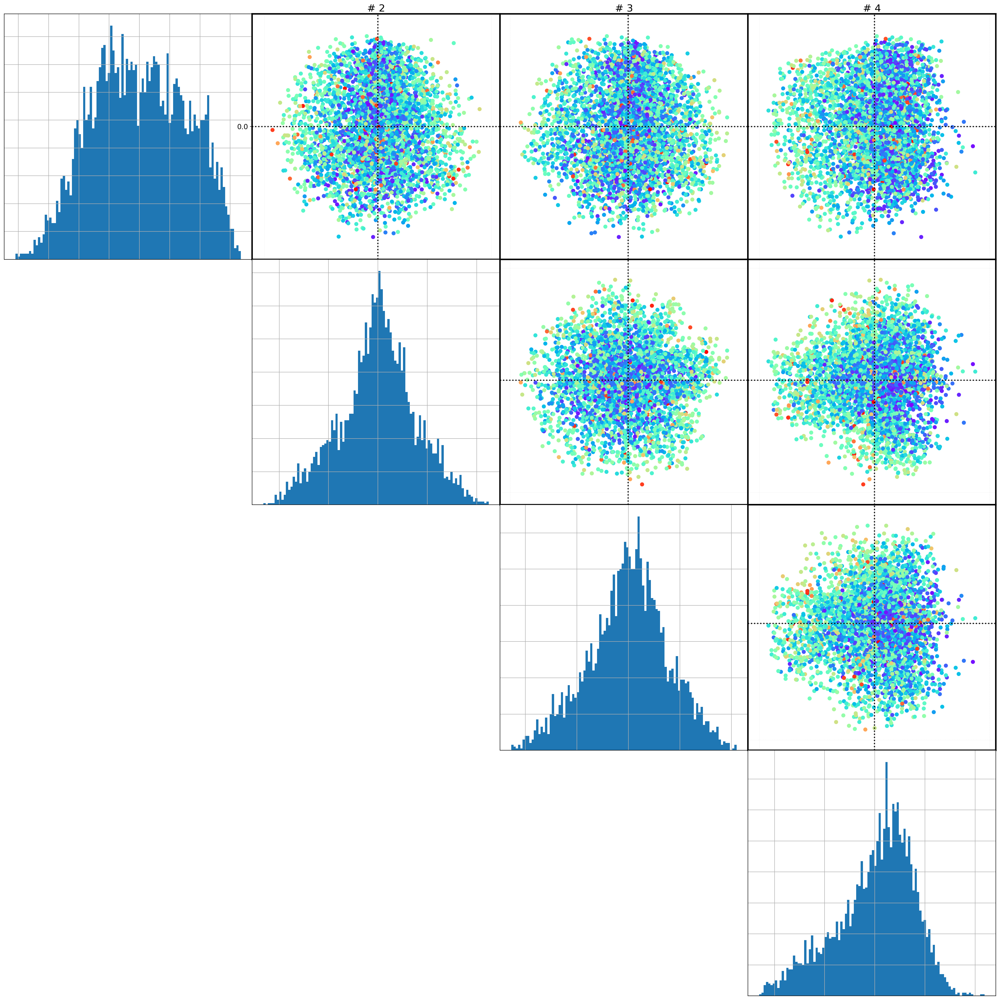

In [29]:
viz.biplots(U_curated, n=4, show_histo=True, nbins=100, c=defocus_curated)

# Parameter prediction

## General quadric fitting

In [30]:
# eventually just keep the first data points (for rapid testing)
sub_sample = U_curated.shape[0] 
# define data array to be fitted
data = U_curated[0:sub_sample,0:3]
# add t vector to data, and define y=0 vector
x = np.concatenate((data.T,np.ones((1,data.shape[0]))),axis=0)
y = np.zeros(data.shape[0])
print(x.shape, y.shape)

(4, 4237) (4237,)


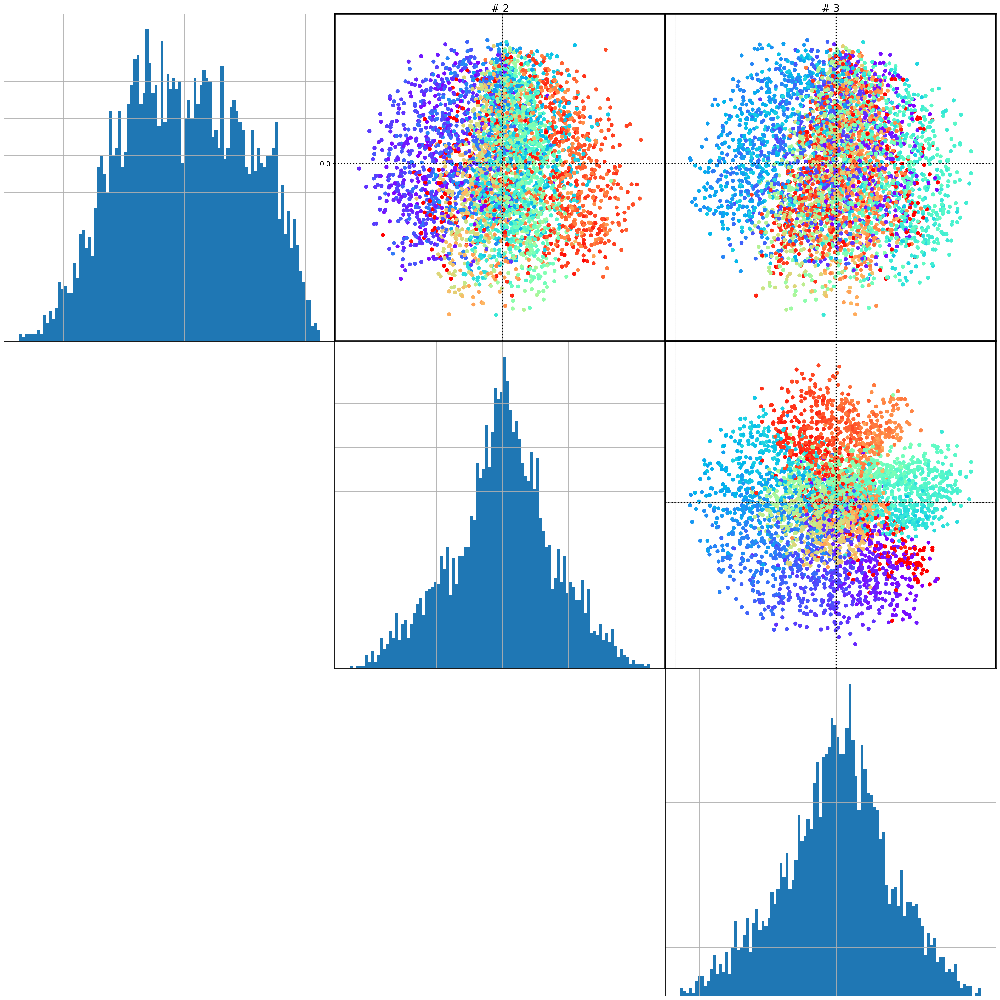

In [31]:
viz.biplots(data, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

In [32]:
dim = x.shape[0]
popt, pcov = pred.curve_fit(pred.quadric_model,
                       x,y,
                       p0=np.ones((np.int(dim*(dim+1)/2))) #p0=[1,-1,-1,0,0,0,0,0,0,0.1]
                      )

/opt/rh/rh-python36/root/usr/lib64/python3.6/site-packages/scipy/optimize/minpack.py:795: OptimizeWarning: Covariance of the parameters could not be estimated
  category=OptimizeWarning)


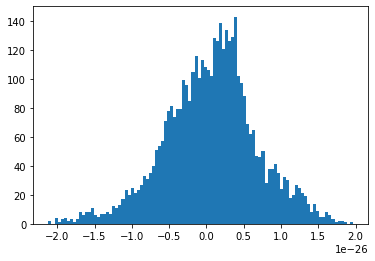

In [33]:
fitData = pred.quadric_model(x, *popt)
plt.hist(fitData, bins=100)
plt.show()

[[-1.46419920e-24 -7.32099602e-25 -7.32099602e-25  3.64757515e-26]
 [-7.32099602e-25 -4.98455785e-24 -2.49227892e-24  2.49088008e-26]
 [-7.32099602e-25 -2.49227892e-24  1.94283346e-24  1.79443373e-25]
 [ 3.64757515e-26  2.49088008e-26  1.79443373e-25  1.66101111e-27]]


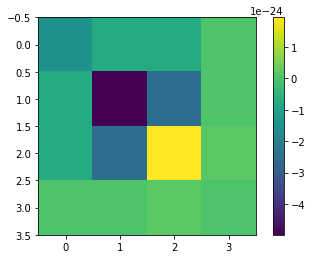

In [34]:
A = pred.quadric_matrix(4,*popt)
print(A)
plt.imshow(A)
plt.colorbar()
plt.show()

-1.1175807774181827e-97 4


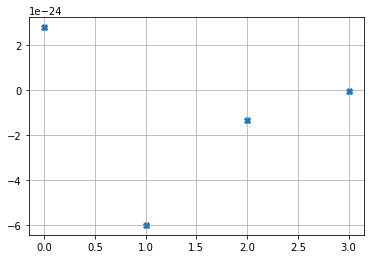

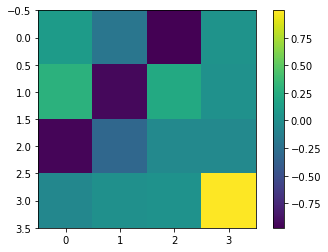

In [35]:
D, P = np.linalg.eig(A)
print(np.linalg.det(np.diag(D)), np.linalg.matrix_rank(A))
plt.plot(D, 'X')
plt.grid()
plt.show()
plt.imshow(P)
plt.colorbar()

### Projection in reduced space

In [36]:
x_oriented = np.dot(P,x).T
x_oriented.shape

(4237, 4)

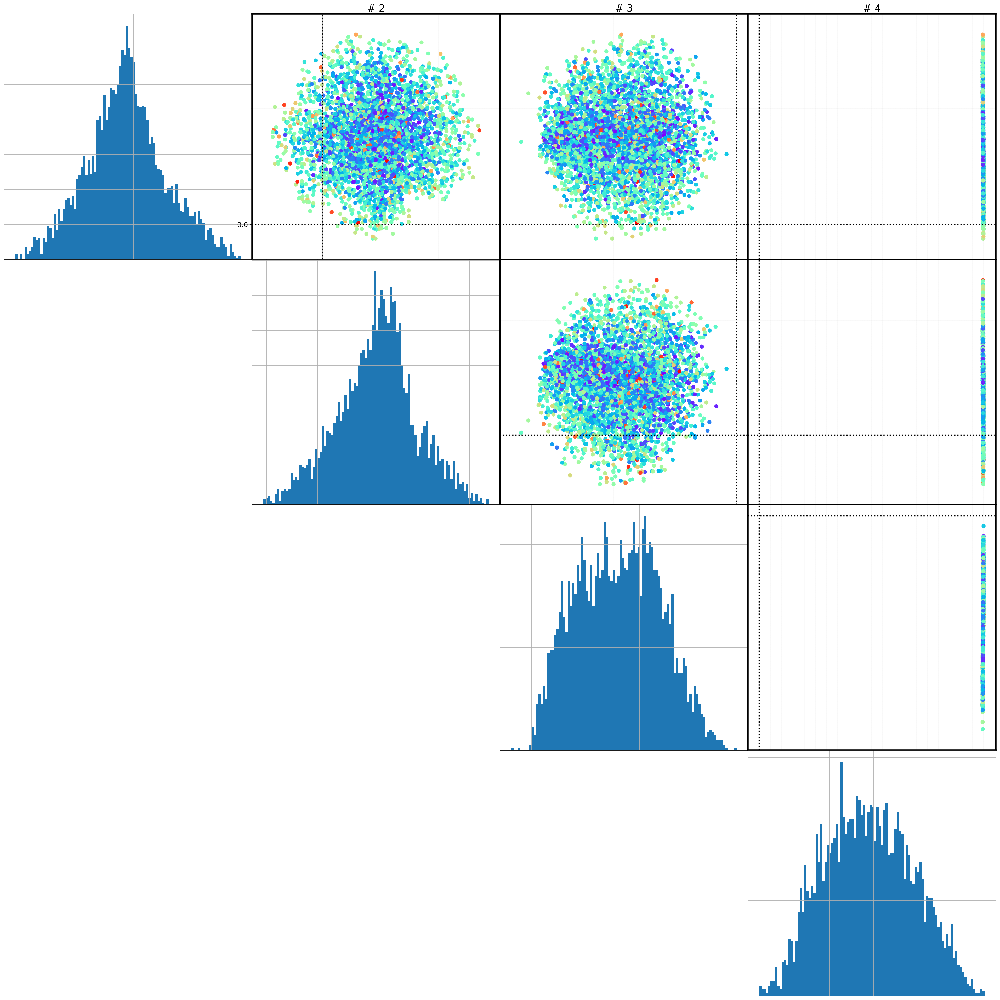

In [37]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

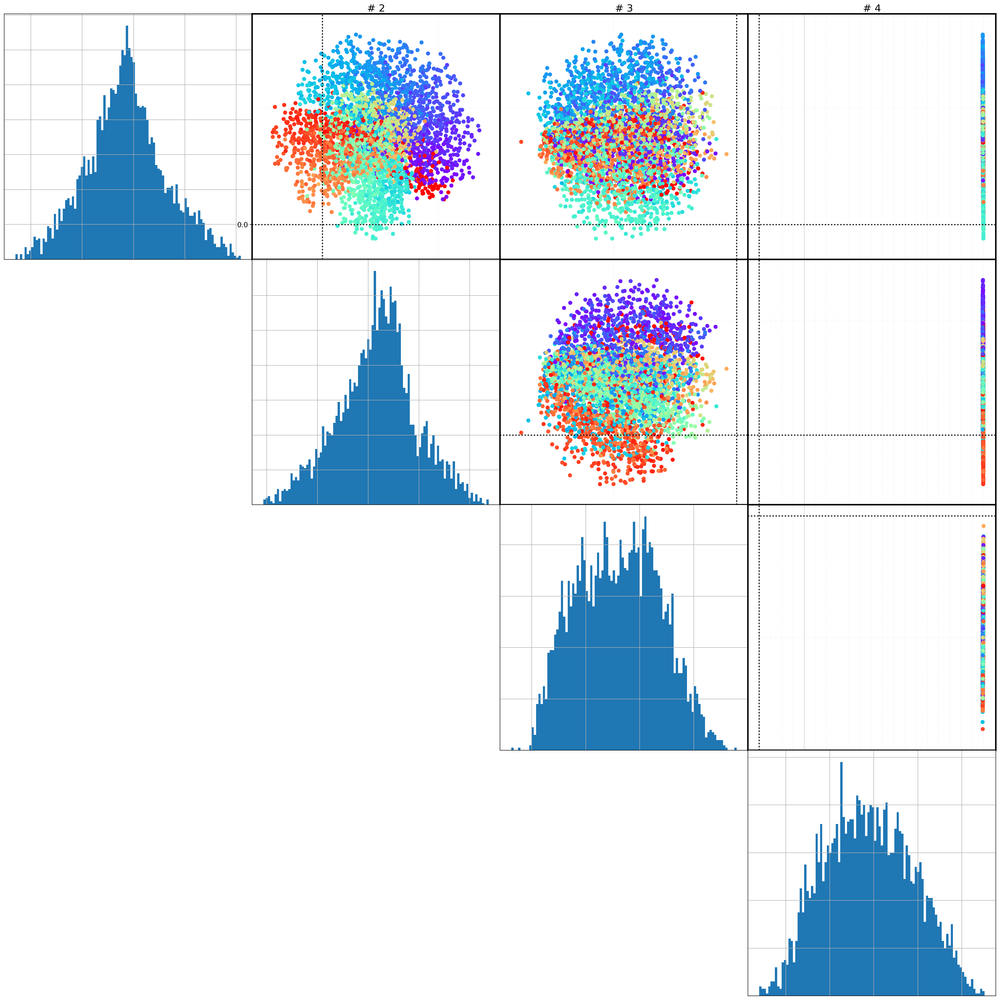

In [38]:
viz.biplots(x_oriented, n=4, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

### Final rescaling 

In [39]:
x_scaled = np.copy(x_oriented)
for i in np.arange(3):
    x_scaled[:,i] /= x_oriented[:,3]
    #x_scaled[:,i] /= 1e12*np.maximum(x_oriented[:,3],1e-12)

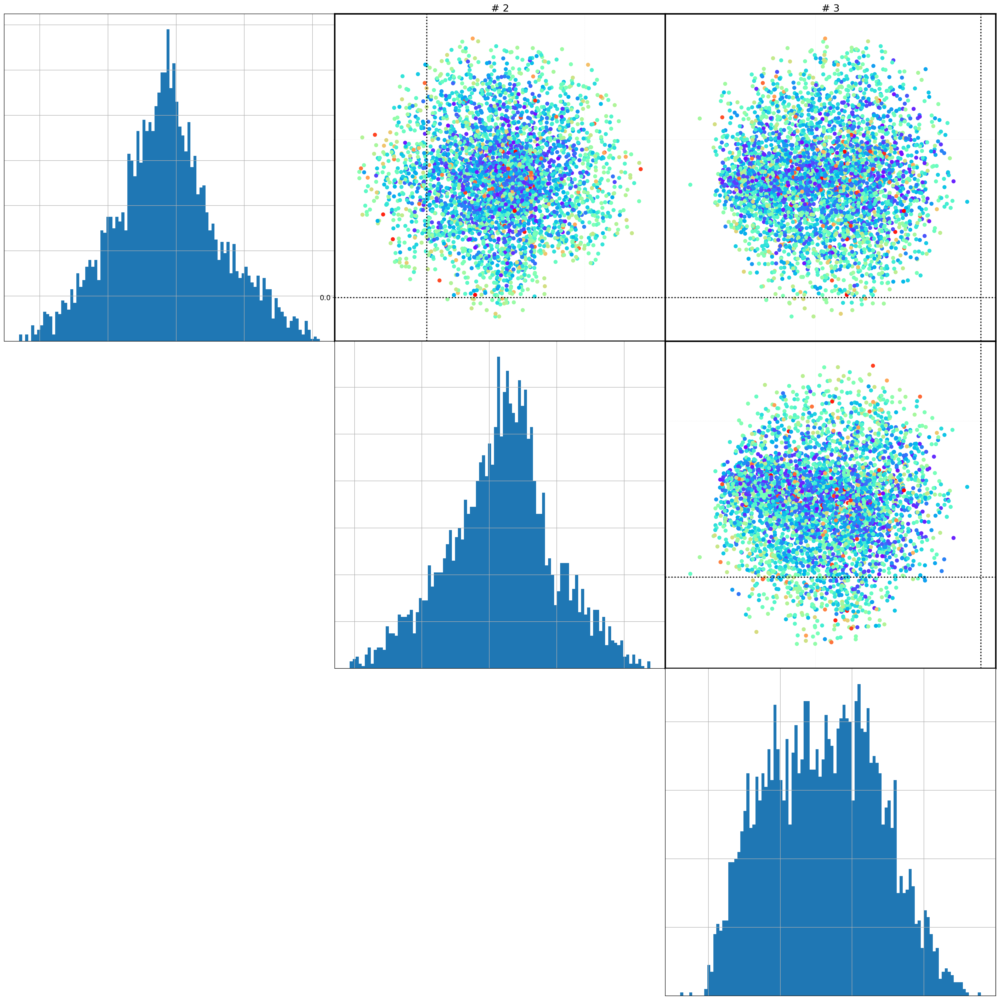

In [40]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=defocus_curated[0:sub_sample])

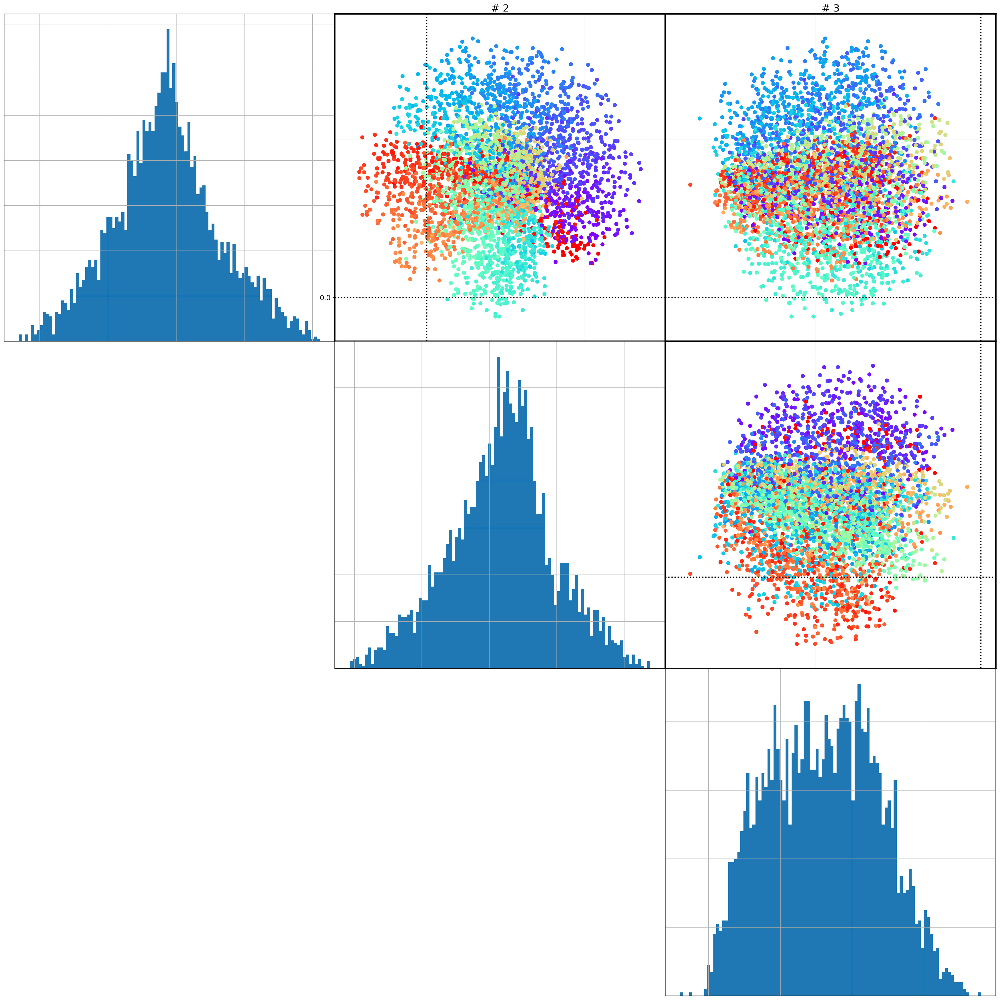

In [41]:
viz.biplots(x_scaled, n=3, show_histo=True, nbins=100, c=angle_curated[0:sub_sample])

## Simple ellipse fitting

In [42]:
angle_true   = angle_curated + 180
defocus_true = defocus_curated

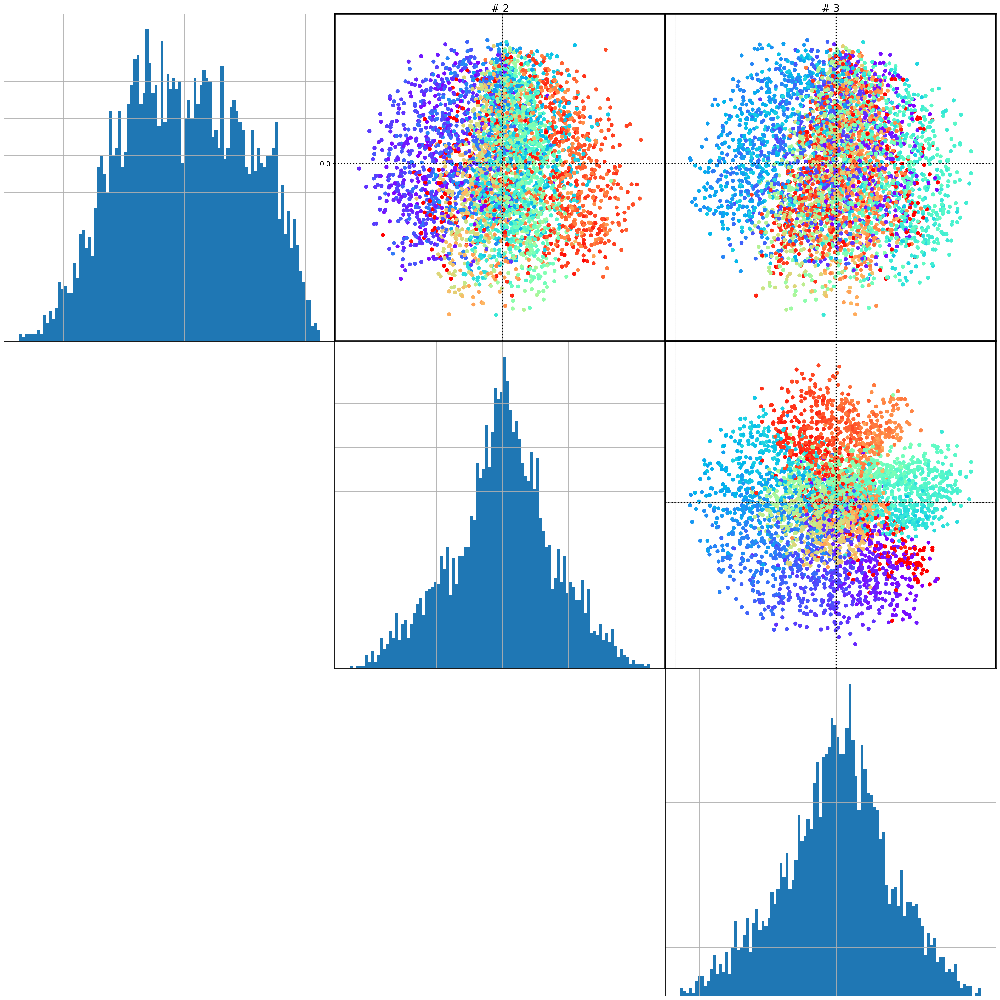

In [43]:
viz.biplots(U_curated, n=3, show_histo=True, nbins=100, c=angle_true)

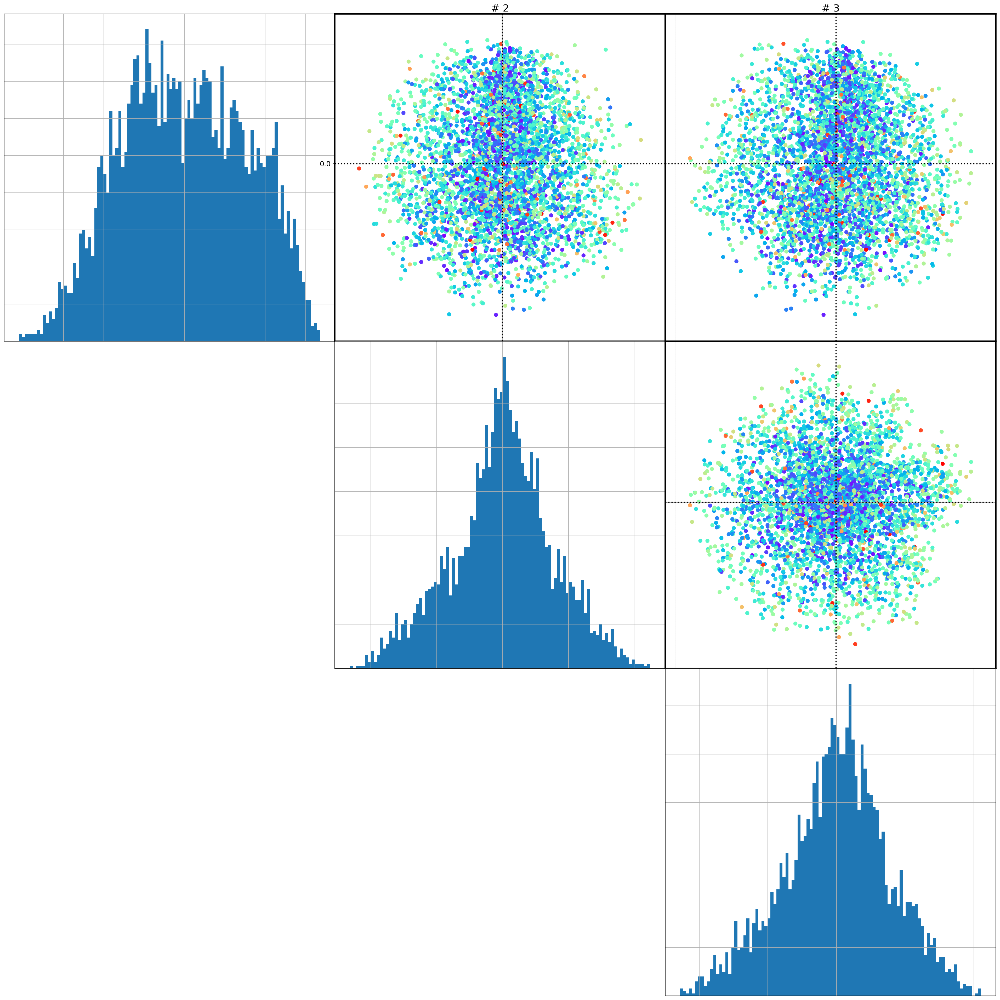

In [44]:
viz.biplots(U_curated, n=3, show_histo=True, nbins=100, c=defocus_true)

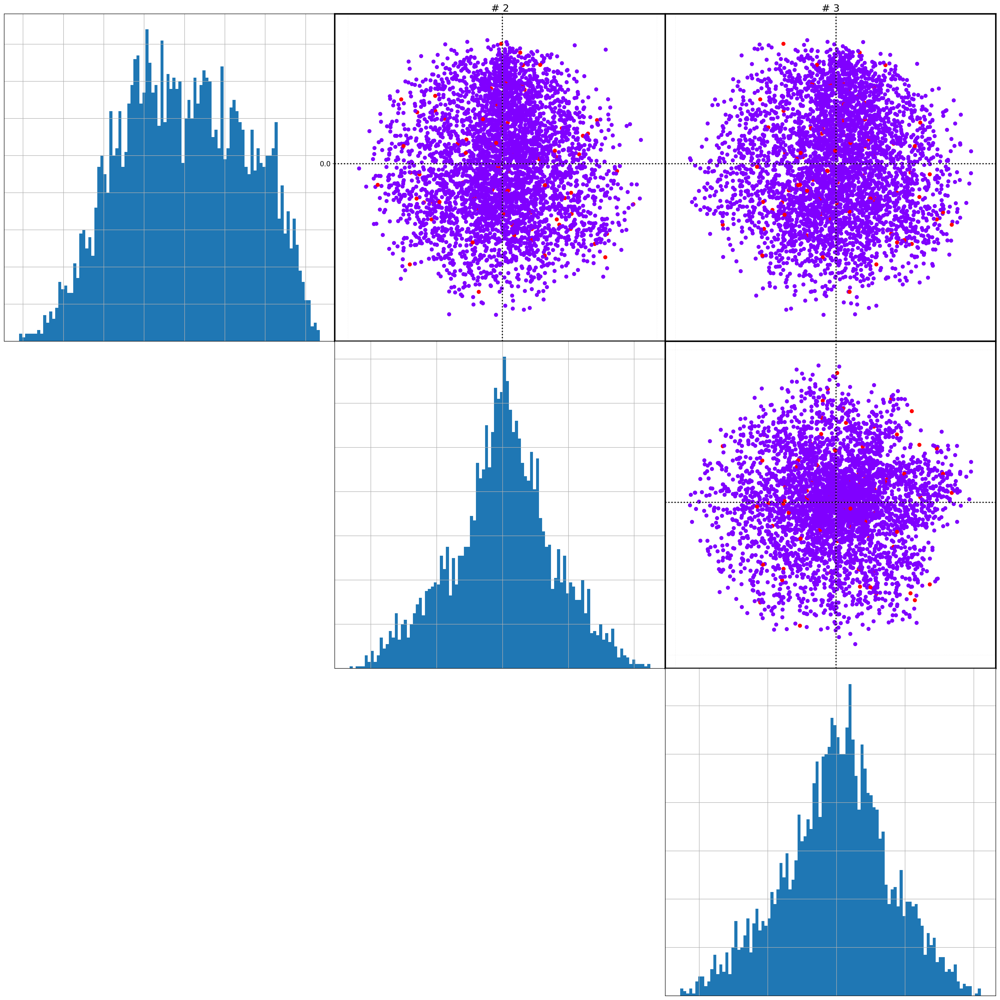

In [45]:
viz.biplots(U_curated, n=3, show_histo=True, nbins=100, c=np.where(Zscore_curated>1,1,0))

In [50]:
angle_pred, defocus_pred = pred.pred2d(U_curated,  angle_true, defocus_true, 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

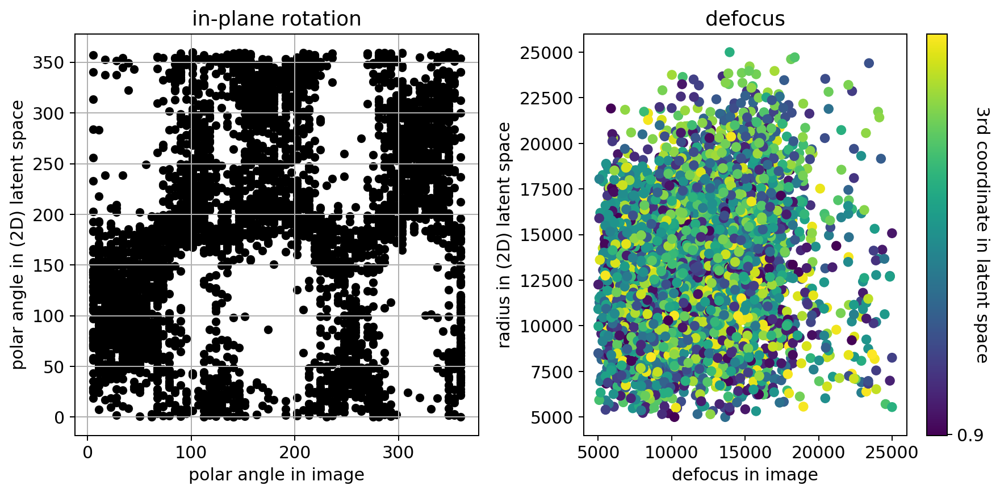

In [51]:
viz.plot_pred2d(angle_pred, defocus_pred, 
                angle_true, defocus_true, 
                metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

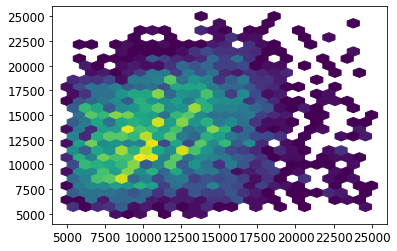

In [52]:
plt.hexbin(defocus_true,defocus_pred,gridsize=25,mincnt=1)

offset: -56.0 angle RMSE = 92.2509749335194
offset: -55.75 angle RMSE = 92.24812351913648
offset: -55.5 angle RMSE = 92.24559130938155
offset: -55.25 angle RMSE = 92.24336502915014
offset: -55.0 angle RMSE = 92.24109425844041
offset: -54.75 angle RMSE = 92.2391219170028
offset: -54.5 angle RMSE = 92.23709912858517
offset: -54.25 angle RMSE = 92.23564108579974
offset: -54.0 angle RMSE = 92.23458804557406
offset: -53.75 angle RMSE = 92.23369455703794
offset: -53.5 angle RMSE = 92.23288755044112
offset: -53.25 angle RMSE = 92.23266696428057
offset: -53.0 angle RMSE = 92.23293362184602
offset: -52.75 angle RMSE = 92.23367513889981
offset: -52.5 angle RMSE = 92.23452236543959
offset: -52.25 angle RMSE = 92.23572166985485
defocus RMSE = 5311.473308163371


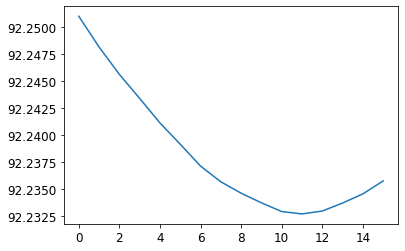

In [58]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-56,-52,0.25))
plt.plot(angle_RMSE_list)

### weight angle RMSE with defocus pred

In [59]:
defocus_pred_normalized = pred.rescale_to_zero_one(defocus_pred)

offset: -46.0 angle RMSE = 87.98522623530671
offset: -45.75 angle RMSE = 87.98239913297583
offset: -45.5 angle RMSE = 87.98012933415559
offset: -45.25 angle RMSE = 87.97821683882911
offset: -45.0 angle RMSE = 87.9769378504116
offset: -44.75 angle RMSE = 87.97633933150027
offset: -44.5 angle RMSE = 87.97583323113831
offset: -44.25 angle RMSE = 87.97583696072823
offset: -44.0 angle RMSE = 87.97638270915655
offset: -43.75 angle RMSE = 87.97749623570331
offset: -43.5 angle RMSE = 87.97900083061188
offset: -43.25 angle RMSE = 87.9811081199519
offset: -43.0 angle RMSE = 87.98362366753638
offset: -42.75 angle RMSE = 87.9866180990026
offset: -42.5 angle RMSE = 87.98999842706861
offset: -42.25 angle RMSE = 87.99407226654834
defocus RMSE = 5311.473308163371


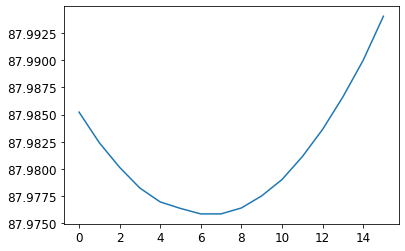

In [64]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-46,-42,0.25),
                                                angle_weight=(np.exp(defocus_pred_normalized)-1), norm_weights=True)
plt.plot(angle_RMSE_list)

offset: -56.0 angle RMSE = 92.2038092999247
offset: -55.75 angle RMSE = 92.20232271273332
offset: -55.5 angle RMSE = 92.20114352617041
offset: -55.25 angle RMSE = 92.20021409379707
offset: -55.0 angle RMSE = 92.19919225971329
offset: -54.75 angle RMSE = 92.19860576429429
offset: -54.5 angle RMSE = 92.19807043178466
offset: -54.25 angle RMSE = 92.19808598970843
offset: -54.0 angle RMSE = 92.19847817478036
offset: -53.75 angle RMSE = 92.19899207599256
offset: -53.5 angle RMSE = 92.19962451216804
offset: -53.25 angle RMSE = 92.20085474943764
offset: -53.0 angle RMSE = 92.20258317084834
offset: -52.75 angle RMSE = 92.20477927472832
offset: -52.5 angle RMSE = 92.20719835322969
offset: -52.25 angle RMSE = 92.20995881078152
defocus RMSE = 5311.473308163371


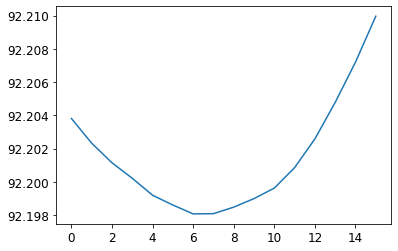

In [67]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true, defocus_true, 
                                                angle_offset_range=np.arange(-56,-52,0.25),
                                                angle_weight=np.exp(-np.abs(Zscore[index])), norm_weights=True)
plt.plot(angle_RMSE_list)